<a href="https://colab.research.google.com/github/ARaj-007/Image-colorization/blob/main/Image_colorization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# **IMAGE-COLORIZATION - BY Abhiyansh Raj** 
'Raja Harishchandra' was the first ever film in India, black and white  ofcourse. Indeed we have come a long way from those B & W days into SUPER-AMOLED crystal clear colourful times . Colours really bring out the emotion in a scene :)
Here's a project an attempt by me to make use of deep learning and see if I can successfully colorize a given black and white image to a colourdul one. 
Hope you like my work, I'll be adding my thoughts and lessons in between the code wherever I feel there's a point worth noting.

Below are the libraries and frameworks we'll be requiring, the code is mainly PyTorch but we will be requiring fastai at a few places to help us build things without complications.

### **APPROACH BASED ON THE PAPER**


In [ ]:
import os
import glob
import numpy as np
import time
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb # we will convert the rgb image into an LAB format 
from tqdm.notebook import tqdm 

import torch
from torch import nn, optim
from torchvision.utils import make_grid
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [ ]:
!pip install fastai==2.4

Now, we will be making use of IMAGES from COCO dataset. This dataset has roughly 20000 images but for our purposes we will making use of roughly 10000.
In which, 8000 will be used for training and the rest 2000 as our validation set.

In [ ]:
from fastai.data.external import untar_data, URLs
data_path = untar_data(URLs.COCO_SAMPLE)
data_path = str(data_path) + "/train_sample"
use_colab = True

In [ ]:
if use_colab == True:
    path = data_path
else:
    path = "Your path to the dataset"# if locally
    
paths = glob.glob(path + "/*.jpg") # IMAGE FILES
np.random.seed(123)#to generate same random state numbers

paths_subset = np.random.choice(paths, 10_000, replace=False) # 10000 images out of 20000 randomly
rand_idxs = np.random.permutation(10_000)

train_idxs = rand_idxs[:8000] # 8000 - training set
val_idxs = rand_idxs[8000:] # 2000 - validation set

train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

print(len(train_paths), len(val_paths))

8000 2000


Now, let's take a look at a few images from the set as examples


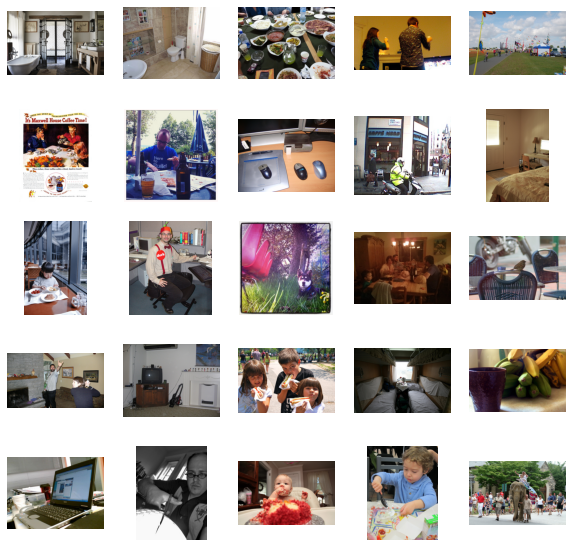

In [ ]:
_, axes = plt.subplots(5, 5, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

## Creating the Dataset class
Here, we will resize the image and flip it horizontally(if it belongs to traing set, data augmentation technique) and convert the RGB image read into Lab colorspace where will separate the input(L) and output(Target - a and b).

-DATA AUGMENTATION : -
Data augmentation in data analysis are techniques used to increase the amount of data by adding slightly modified copies of already existing data or newly created synthetic data from existing data. It acts as a regularizer and helps reduce overfitting when training a machine learning model.

-RGB AND LAB :- 
RGB data represents colour in RGB colour space where there are 3 numbers for each pixel indicating how much Red, Green, and Blue the pixel is.
LAB on the other hand represents 3 channels - L channel , *a channel, *b channel where L represents lightness, and the other two encode how much green-red and yellow-blue each pixel is respectfully.

![download.jpeg](https://drive.google.com/uc?id=1tyBE2lUHJL2Z-W9U66FFEplBFjvykBMD)

*Credits for image - Graeme Cookson / Shutha.org*


In [ ]:
#MAKING THE DATACLASS

class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((256, 256),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), #Data augmentation technique
            ])
        elif split == 'val': # if the image belongs to validation set we do not flip it
            self.transforms = transforms.Resize((256, 256),  Image.BICUBIC)
        
        self.split = split
        self.size = 256
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to LAB colour space as told above
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # scaling the values between -1 and 1
        ab = img_lab[[1, 2], ...] / 110.
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

#creating the dataloader

def img_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs):
    dataset = ColorizationDataset(**kwargs) # autocall to the dataset class
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

let's see if this works:-

In [ ]:
train_dl = img_dataloaders(paths=train_paths, split='train')
val_dl = img_dataloaders(paths=val_paths, split='val')

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:281: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


# Making the Generator
Here we make use of U-Net architecture in the generator of our GAN.

Working : - The U-Net adds down-sampling and up-sampling modules to the left and right of that middle module (respectively) at every iteration until it reaches the input module and output module.

In [ ]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, inplace = True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

In [ ]:
#Now, let's have a visual look of our generator model
generator_model = Unet()
print(generator_model)

In [ ]:
#Generator Model Summary
#uncomment if runtime is not set to GPU
#from torchsummary import summary
#summary(generator_model, (1,256,256))

#Making the **Discriminator**
Now, below is the code for our discriminator. Here, we are stacking blocks of Conv-BatchNorm-LeackyRelu to make a decision about the reality or fakeness of our input image.

-We will not apply normalization to first and last blocks and the last block will have no activation function too.

## **Patch Discriminator**
In a normal discriminator, the model only gives out 1 number which represents what the model thinks of the input as in the whole image whether it is real or fake. On the other hand, our patch disciminator works on every patch like 50 by 50 pixels of the input image and for each patch it decides whether it is fake or not.

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement ensures not using stride of 2 for last block
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # No normalization or activation for last layer
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [ ]:
#Visualizing our discriminator
discriminator = PatchDiscriminator(3)
discriminator


In [ ]:
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

# GAN LOSS CLASS

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

#MODEL INITIALIZATION 
We will initialize the weights of our model with a mean of 0.0 and standard deviation of 0.02, the hyperparameters proposed in the paper.

In [ ]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

#Creating the Main Model Class
Now, let's put together everything that we have created together.

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)

        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device) #GAN LOSS
        self.L1criterion = nn.L1Loss()                                  #L1 LOSS(MAE)

        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2)) #OPTIMIZER - GENERATOR
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2)) #OPTIMIZER - DISCRIMINATOR
    
    def set_requires_grad(self, model, requires_grad=True): #setting the requires_gradof our parameters
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data): #sending input to CUDA(if gpu)
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):        #Backpropagation in the generator
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self): #Backpropogation for discriminator
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

# Some Helpful Functions

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

#TRAINING THE MODEL


In [ ]:
#epochs = 100
def train_model(model, train_dl, epochs):
    valid_data = next(iter(val_dl))
    loss_D = [] #storing the losses
    loss_G_GAN = []
    loss_G_L1 = []
    loss_G = []

    for e in range(epochs):
        model_name = f"imgcl_model_{e+1}.pt"
        path = f"/content/gdrive/My Drive/Image-colourization/{model_name}" 
        torch.save(model.state_dict(), path)
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to log the losses
                                         
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
        
        # Adding the losses 
        loss_D.append(loss_meter_dict["loss_D"])
        loss_G_GAN.append(loss_meter_dict["loss_G_GAN"])
        loss_G_L1.append(loss_meter_dict["loss_G_L1"])
        loss_G.append(loss_meter_dict["loss_G"])

        print(f"\nEpoch {e+1}/{epochs}")
        log_results(loss_meter_dict) # function to print out the losses
        visualize(model, valid_data, e) # function displaying the model's outputs

#model = MainModel()
#train_model(model, train_dl, epochs)#for 100 epochs

the training stopped after around 25 epochs(laptop went to sleep mode)
So we will load our last saved model and continue training it for some time longer around 20-25 epochs.

In [ ]:
#plt.plot(x, loss_D, label = "loss_D")
#plt.plot(x, loss_G, label = "loss_G")

model initialized with norm initialization
model initialized with norm initialization


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/30
loss_D_fake: 0.52722
loss_D_real: 0.55559
loss_D: 0.54141
loss_G_GAN: 1.27880
loss_G_L1: 8.92133
loss_G: 10.20013


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


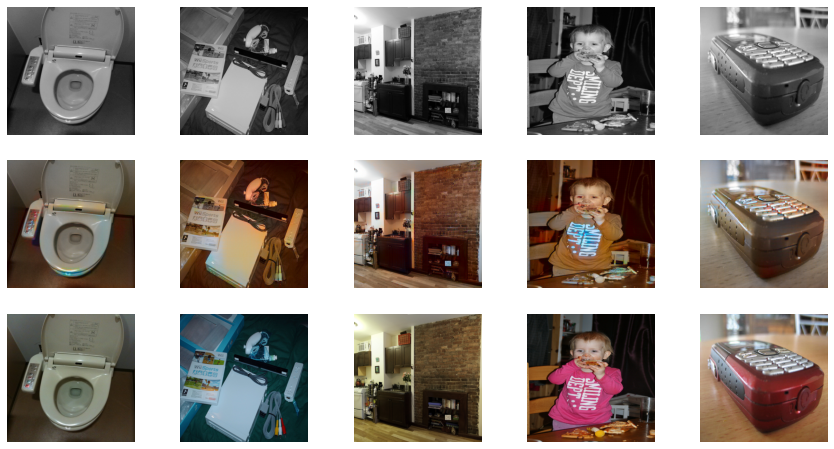

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/30
loss_D_fake: 0.52623
loss_D_real: 0.55211
loss_D: 0.53917
loss_G_GAN: 1.27666
loss_G_L1: 8.79471
loss_G: 10.07138


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


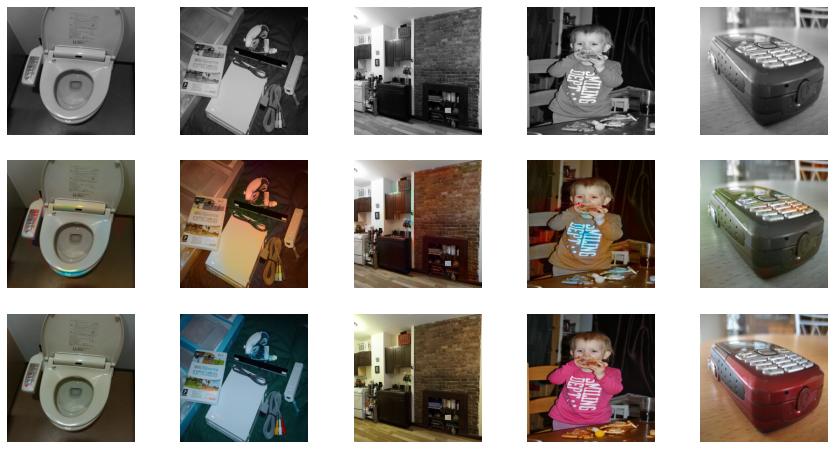

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/30
loss_D_fake: 0.52544
loss_D_real: 0.54530
loss_D: 0.53537
loss_G_GAN: 1.29047
loss_G_L1: 8.70003
loss_G: 9.99050


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


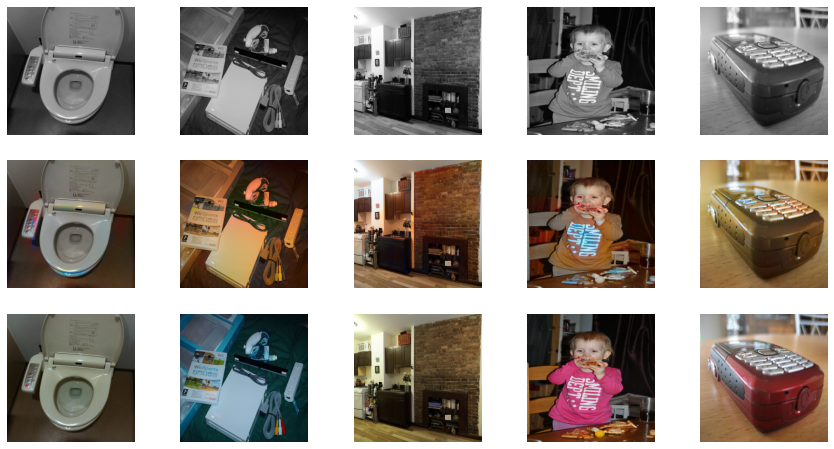

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/30
loss_D_fake: 0.53405
loss_D_real: 0.54794
loss_D: 0.54099
loss_G_GAN: 1.28418
loss_G_L1: 8.54217
loss_G: 9.82635


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


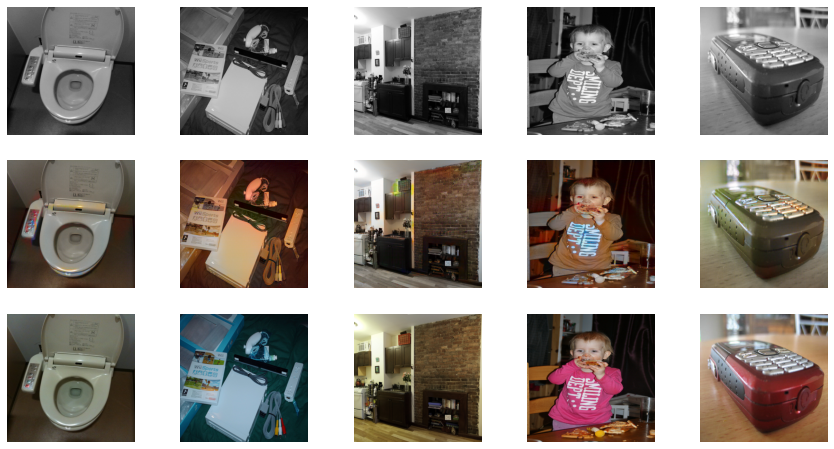

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/30
loss_D_fake: 0.52229
loss_D_real: 0.53511
loss_D: 0.52870
loss_G_GAN: 1.30444
loss_G_L1: 8.47373
loss_G: 9.77817


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


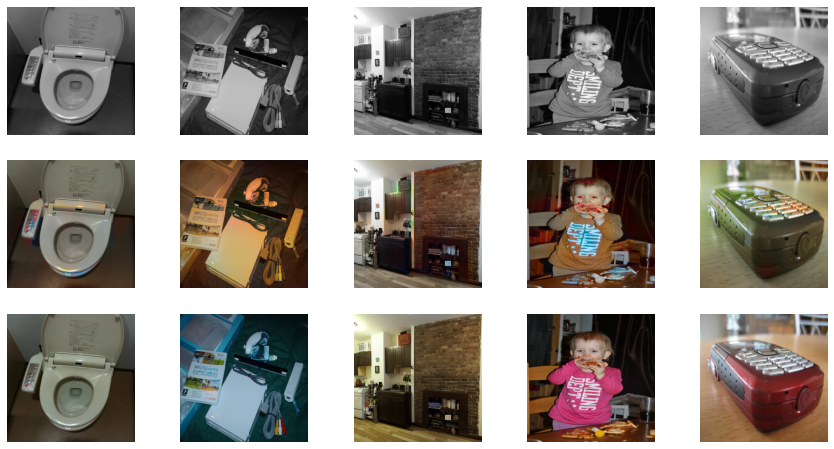

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/30
loss_D_fake: 0.53861
loss_D_real: 0.54930
loss_D: 0.54396
loss_G_GAN: 1.32221
loss_G_L1: 8.34079
loss_G: 9.66299


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


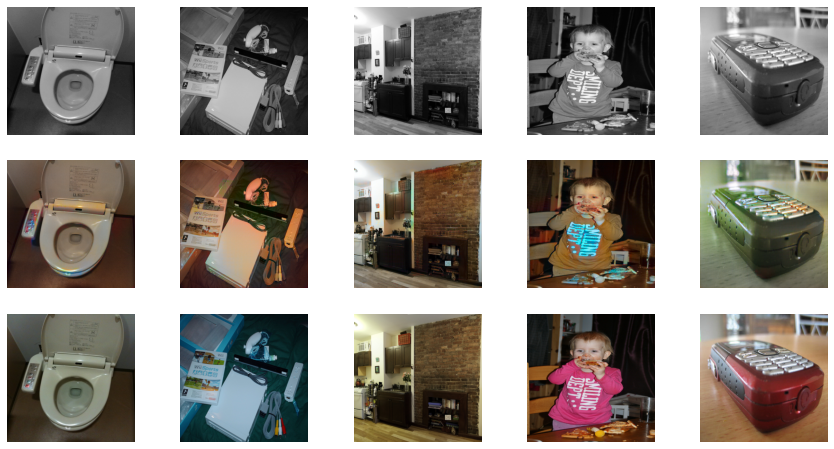

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/30
loss_D_fake: 0.51746
loss_D_real: 0.52423
loss_D: 0.52084
loss_G_GAN: 1.30957
loss_G_L1: 8.18559
loss_G: 9.49517


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 183 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


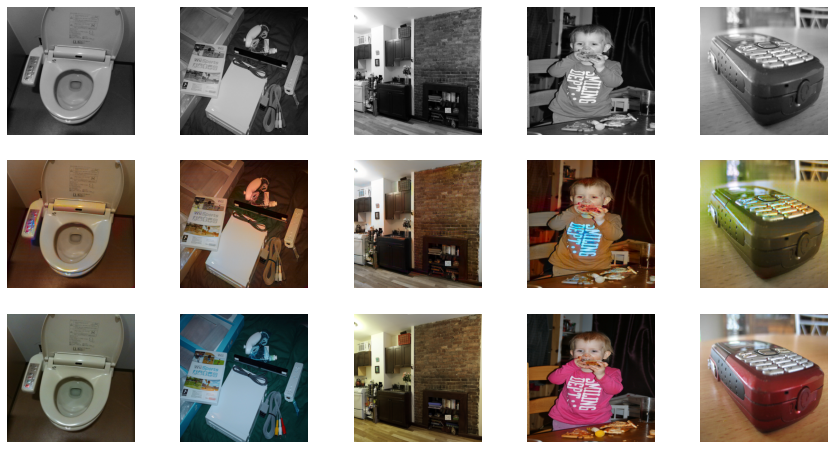

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/30
loss_D_fake: 0.52583
loss_D_real: 0.53128
loss_D: 0.52856
loss_G_GAN: 1.32316
loss_G_L1: 8.11221
loss_G: 9.43536


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 42 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


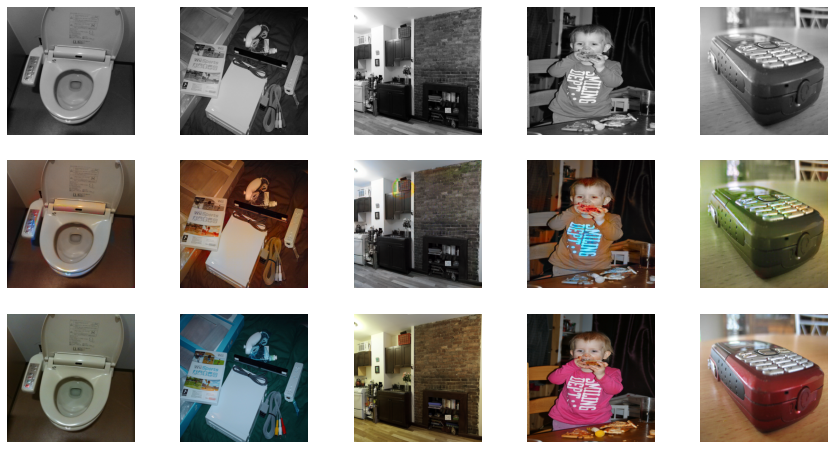

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/30
loss_D_fake: 0.52230
loss_D_real: 0.52774
loss_D: 0.52502
loss_G_GAN: 1.33105
loss_G_L1: 8.02369
loss_G: 9.35474


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 90 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


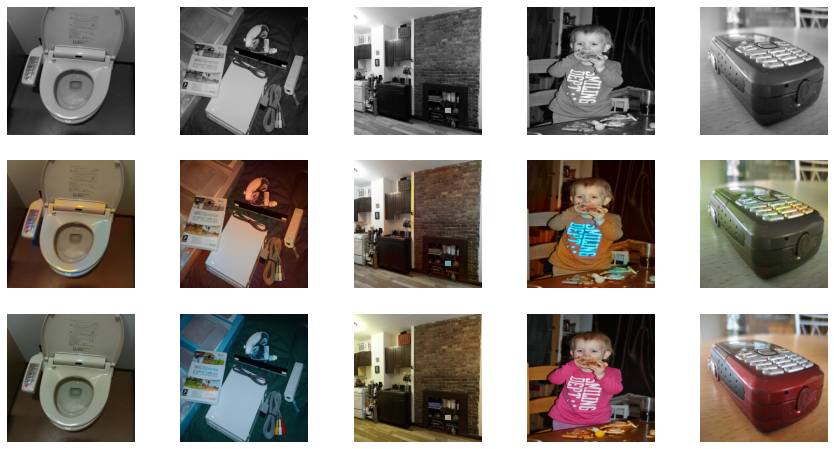

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/30
loss_D_fake: 0.52105
loss_D_real: 0.52182
loss_D: 0.52144
loss_G_GAN: 1.33526
loss_G_L1: 7.91084
loss_G: 9.24610


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


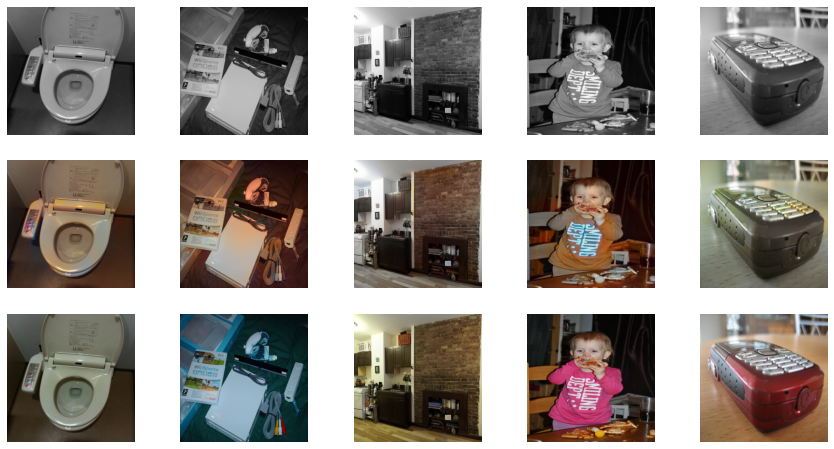

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/30
loss_D_fake: 0.53478
loss_D_real: 0.53810
loss_D: 0.53644
loss_G_GAN: 1.34369
loss_G_L1: 7.80146
loss_G: 9.14516


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 39 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


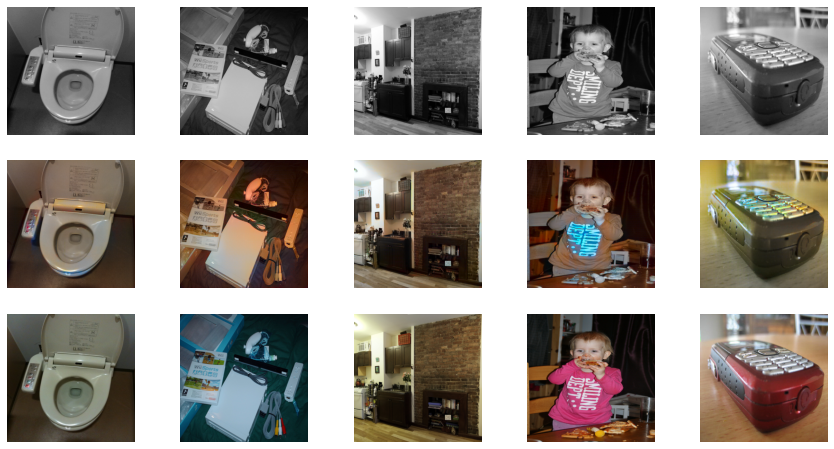

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/30
loss_D_fake: 0.51399
loss_D_real: 0.51595
loss_D: 0.51497
loss_G_GAN: 1.35361
loss_G_L1: 7.72777
loss_G: 9.08138


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 41 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


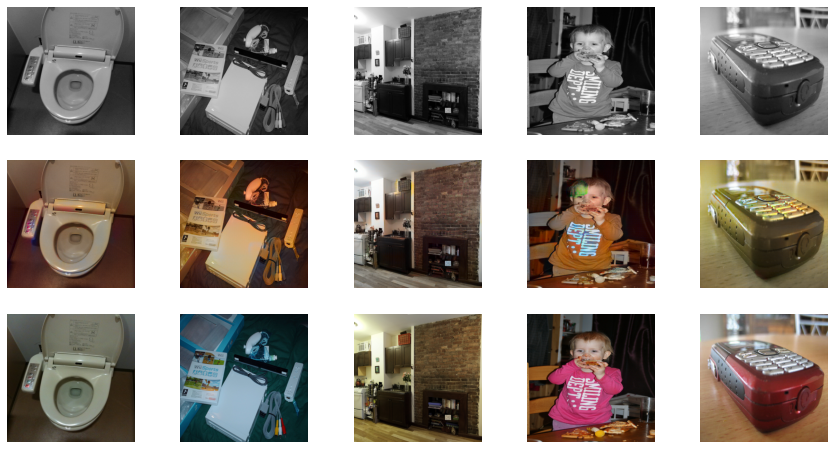

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/30
loss_D_fake: 0.51863
loss_D_real: 0.51917
loss_D: 0.51890
loss_G_GAN: 1.36202
loss_G_L1: 7.62808
loss_G: 8.99010


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


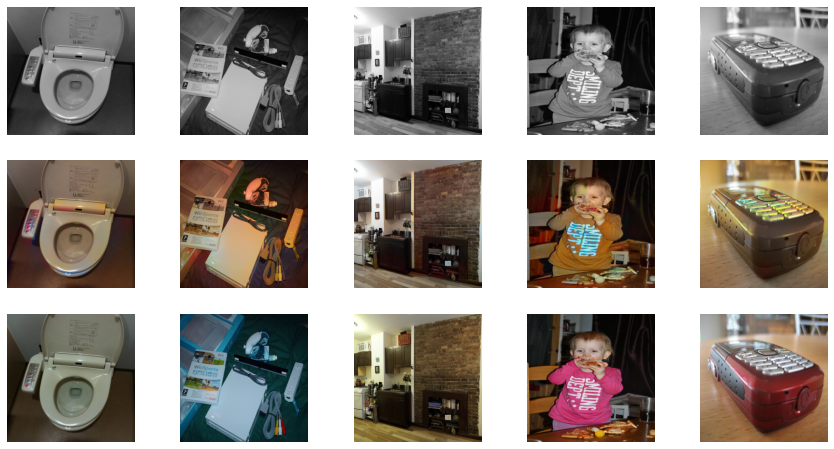

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/30
loss_D_fake: 0.51158
loss_D_real: 0.51414
loss_D: 0.51286
loss_G_GAN: 1.37280
loss_G_L1: 7.55793
loss_G: 8.93073


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


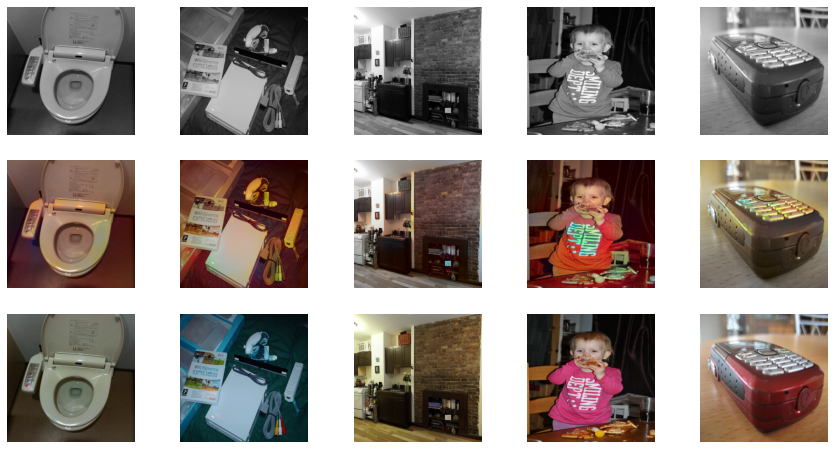

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/30
loss_D_fake: 0.51197
loss_D_real: 0.51665
loss_D: 0.51431
loss_G_GAN: 1.37938
loss_G_L1: 7.47842
loss_G: 8.85780


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


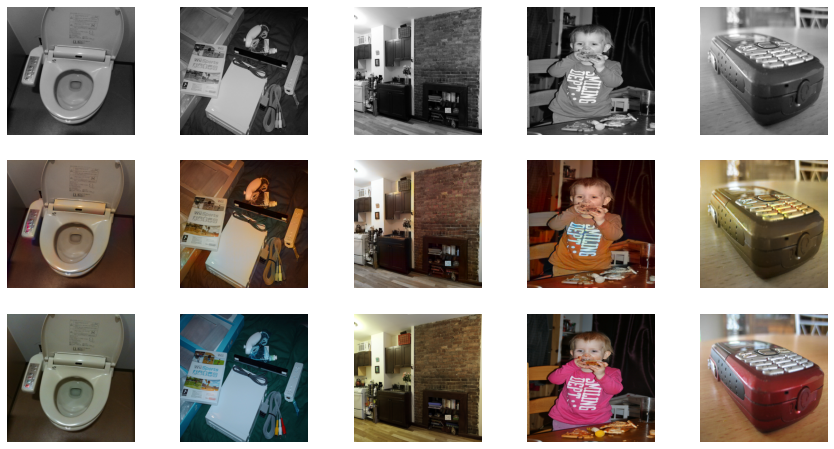

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/30
loss_D_fake: 0.51489
loss_D_real: 0.51399
loss_D: 0.51444
loss_G_GAN: 1.38355
loss_G_L1: 7.39956
loss_G: 8.78312


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


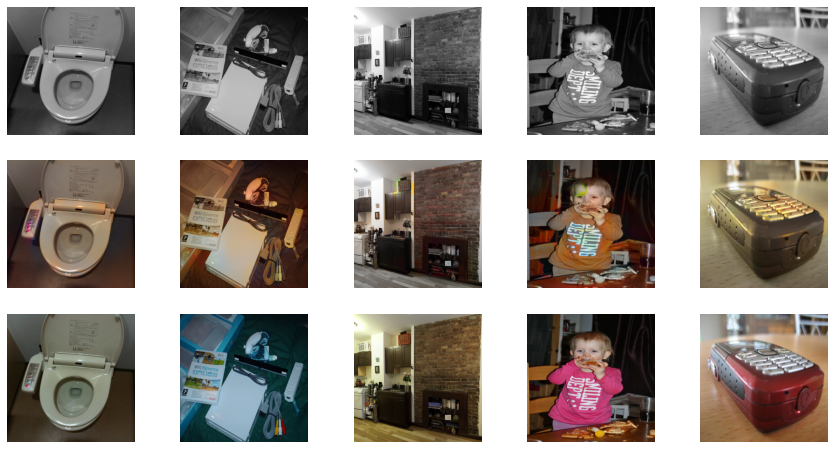

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/30
loss_D_fake: 0.51643
loss_D_real: 0.51353
loss_D: 0.51498
loss_G_GAN: 1.38498
loss_G_L1: 7.31349
loss_G: 8.69847


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


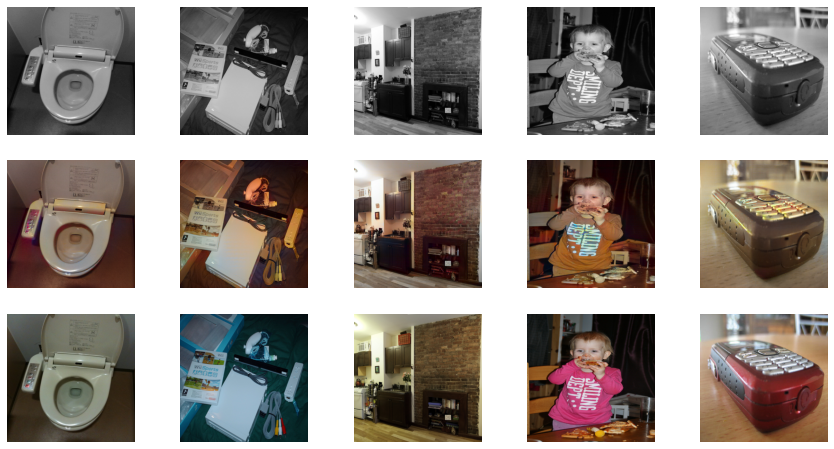

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/30
loss_D_fake: 0.50918
loss_D_real: 0.51374
loss_D: 0.51146
loss_G_GAN: 1.39341
loss_G_L1: 7.25693
loss_G: 8.65034


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


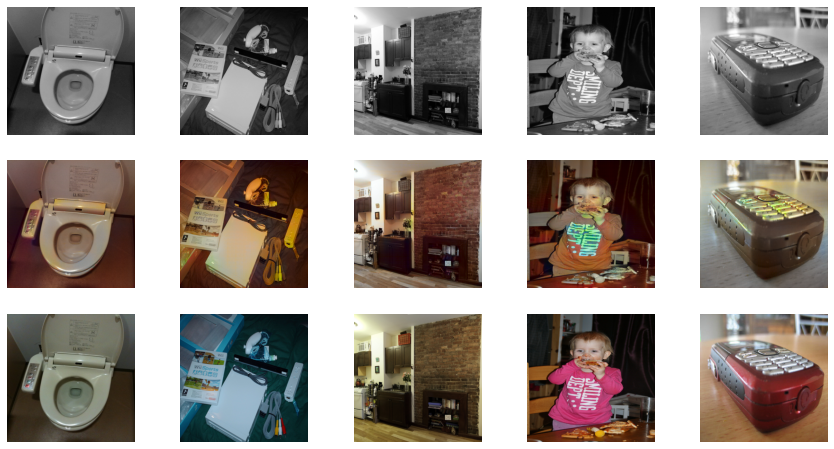

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 19/30
loss_D_fake: 0.50700
loss_D_real: 0.50734
loss_D: 0.50717
loss_G_GAN: 1.40975
loss_G_L1: 7.21003
loss_G: 8.61978


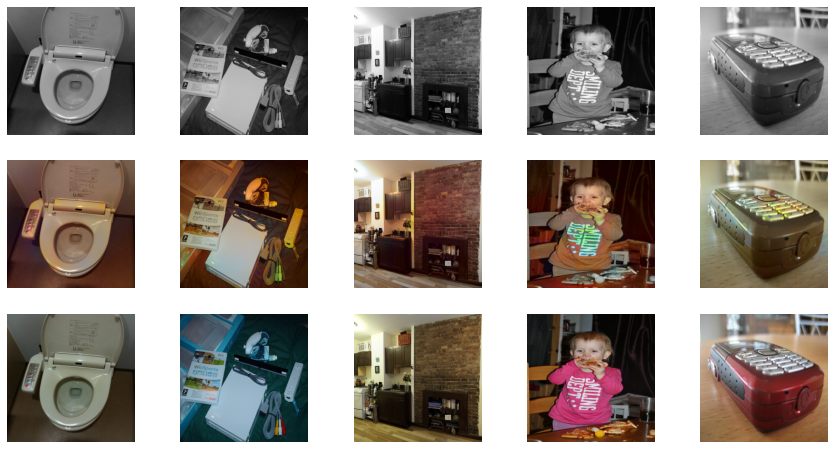

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 20/30
loss_D_fake: 0.53098
loss_D_real: 0.52914
loss_D: 0.53006
loss_G_GAN: 1.41040
loss_G_L1: 7.12815
loss_G: 8.53855


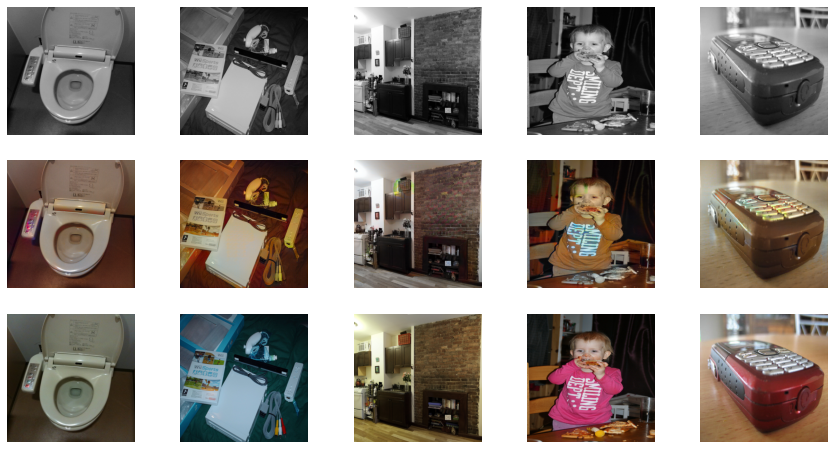

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 21/30
loss_D_fake: 0.49321
loss_D_real: 0.49566
loss_D: 0.49443
loss_G_GAN: 1.40654
loss_G_L1: 7.07144
loss_G: 8.47798


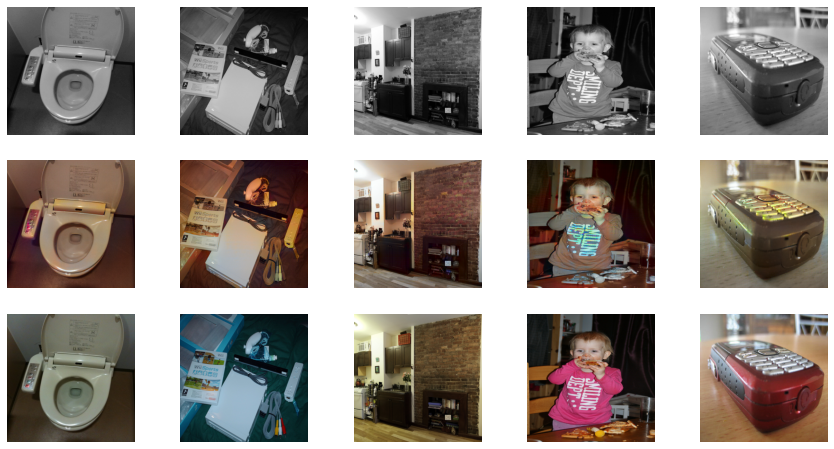

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 22/30
loss_D_fake: 0.52961
loss_D_real: 0.52272
loss_D: 0.52616
loss_G_GAN: 1.41492
loss_G_L1: 6.97606
loss_G: 8.39097


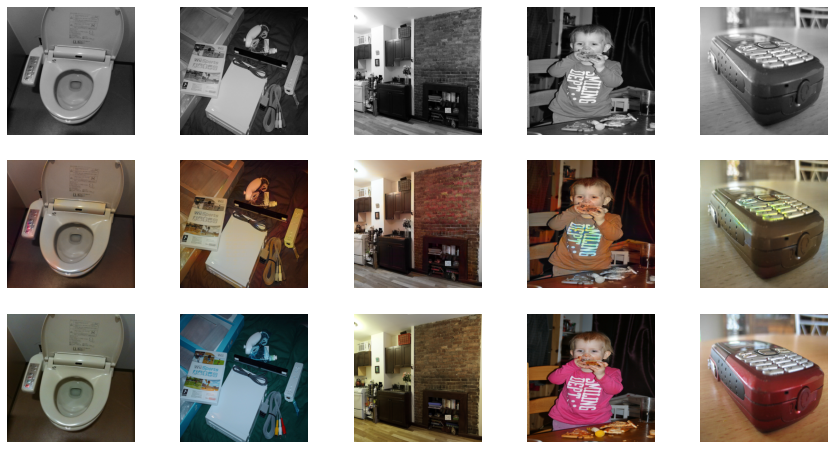

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 23/30
loss_D_fake: 0.49311
loss_D_real: 0.49344
loss_D: 0.49328
loss_G_GAN: 1.42442
loss_G_L1: 6.94881
loss_G: 8.37323


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


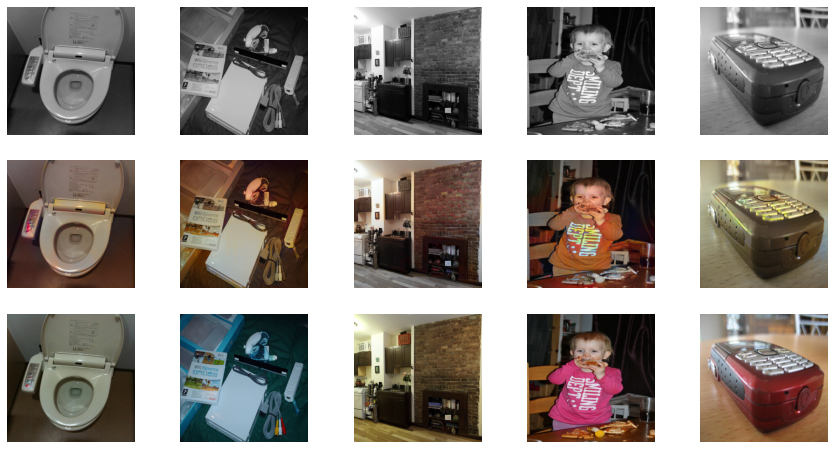

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 24/30
loss_D_fake: 0.50885
loss_D_real: 0.50670
loss_D: 0.50777
loss_G_GAN: 1.44834
loss_G_L1: 6.88799
loss_G: 8.33634


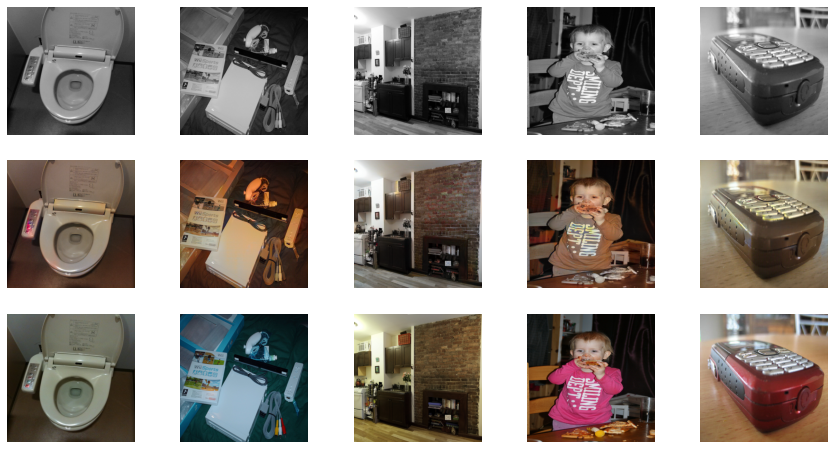

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 25/30
loss_D_fake: 0.49905
loss_D_real: 0.49480
loss_D: 0.49693
loss_G_GAN: 1.43668
loss_G_L1: 6.81963
loss_G: 8.25631


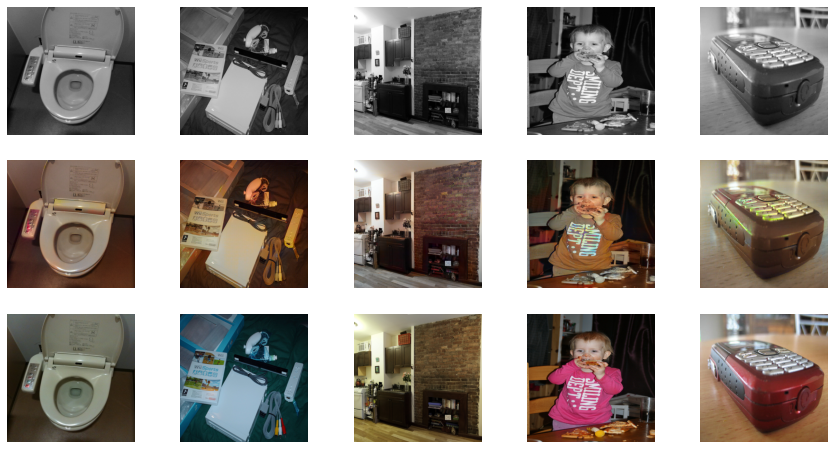

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 26/30
loss_D_fake: 0.50840
loss_D_real: 0.50652
loss_D: 0.50746
loss_G_GAN: 1.46325
loss_G_L1: 6.76799
loss_G: 8.23124


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


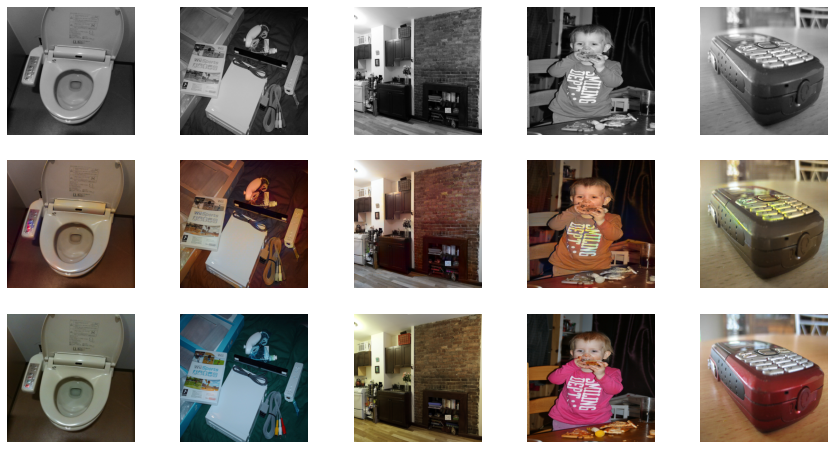

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 27/30
loss_D_fake: 0.50092
loss_D_real: 0.50212
loss_D: 0.50152
loss_G_GAN: 1.47350
loss_G_L1: 6.70871
loss_G: 8.18221


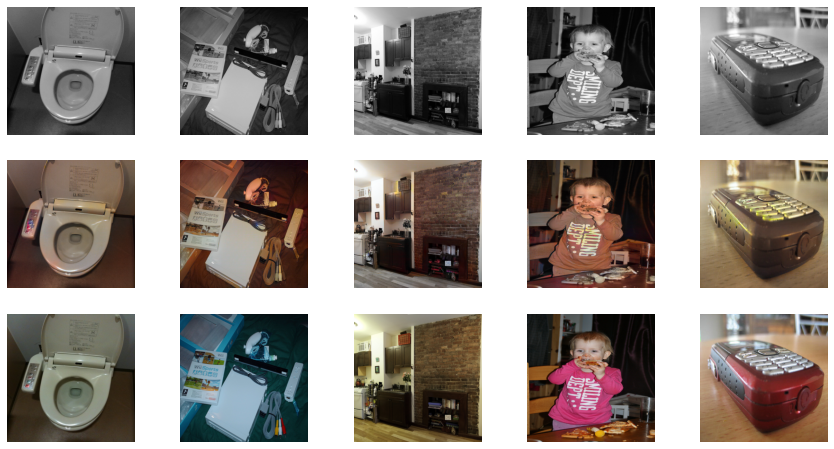

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 28/30
loss_D_fake: 0.48644
loss_D_real: 0.48598
loss_D: 0.48621
loss_G_GAN: 1.48622
loss_G_L1: 6.68525
loss_G: 8.17147


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


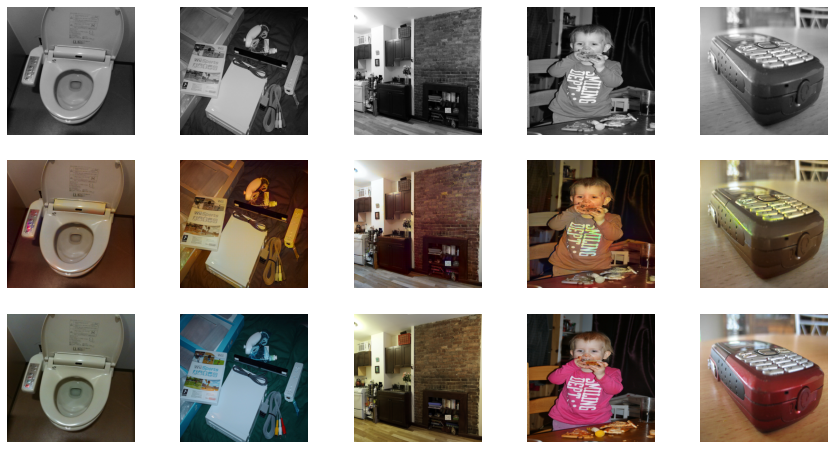

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 29/30
loss_D_fake: 0.51510
loss_D_real: 0.51236
loss_D: 0.51373
loss_G_GAN: 1.49453
loss_G_L1: 6.60567
loss_G: 8.10020


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


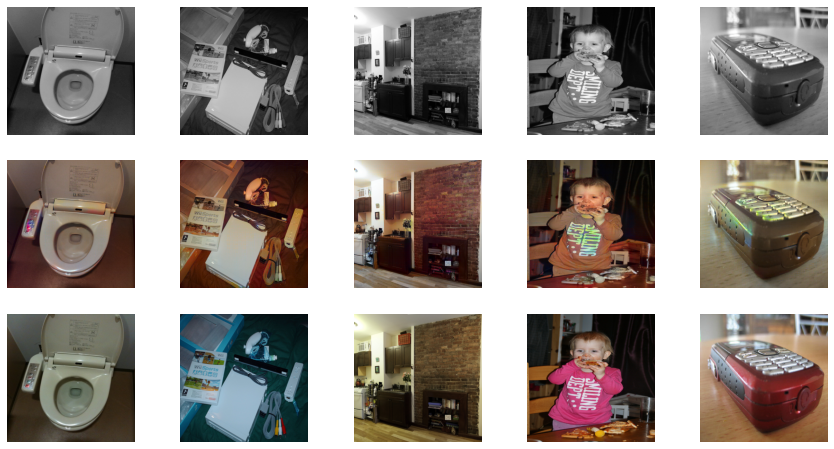

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 30/30
loss_D_fake: 0.48499
loss_D_real: 0.48256
loss_D: 0.48377
loss_G_GAN: 1.48932
loss_G_L1: 6.58109
loss_G: 8.07042


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


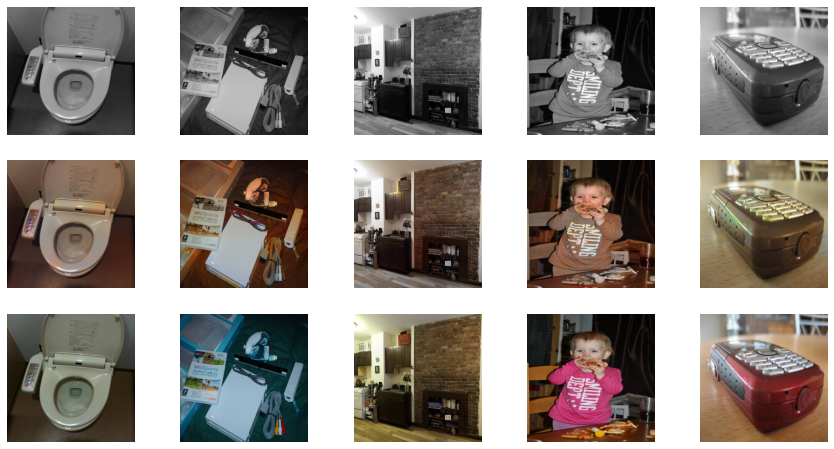

In [ ]:
model = MainModel()
model_save_name = 'imgcl_model_23.pt'
path = f"/content/gdrive/My Drive/Image-colourization/{model_save_name}"
model.load_state_dict(torch.load(path))
epochs = 30
train_model(model, train_dl, epochs)#for 30 epochs

#An observation
Indeed, we have come a long way and the results we have obtained our good(after about 50 epochs) but as we can see , the model still does not recognize the colour of some objects. Let us now apply a different approach.

#NEW MODEL
Here, first we are going to pre train the generator in a superwised manner.
This will be done in 2 stages: Stage 1: - The backbone of the generator (the down sampling path) is a pretrained model for classification (on ImageNet) 2- The whole generator will be pretrained on the task of colorization with L1 loss.

We will be using a pretrained ResNet18 as the backbone of our U-Net and further we will train that U-Net on our training set with L1 Loss. Last but not least we will have the combined adversial and L1 loss as done earlier.

##New Generator
We will use fastai (as mentioned earlier) library's Dynamic U-Net module to avoid complicated stuff.

In [ ]:
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

### Pre-Training the generator

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()        
pretrain_generator(net_G, train_dl, opt, criterion, 20)
torch.save(net_G.state_dict(), "res18-unet.pt")
# we will train this for about 20 epochs

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

  0%|          | 0/500 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Epoch 1/20
L1 Loss: 0.08617


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 2/20
L1 Loss: 0.08281


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 3/20
L1 Loss: 0.08232


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 4/20
L1 Loss: 0.08188


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 5/20
L1 Loss: 0.08139


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 6/20
L1 Loss: 0.08097


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 7/20
L1 Loss: 0.08057


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 8/20
L1 Loss: 0.08000


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 9/20
L1 Loss: 0.07919


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 10/20
L1 Loss: 0.07860


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 11/20
L1 Loss: 0.07753


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 12/20
L1 Loss: 0.07669


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 13/20
L1 Loss: 0.07567


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 14/20
L1 Loss: 0.07477


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 15/20
L1 Loss: 0.07336


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 16/20
L1 Loss: 0.07236


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 17/20
L1 Loss: 0.07143


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 18/20
L1 Loss: 0.07039


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 19/20
L1 Loss: 0.06963


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 20/20
L1 Loss: 0.06896


#OUR FINAL MODEL
Now,let us put our new changes into effect.

model initialized with norm initialization


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/20
loss_D_fake: 0.58867
loss_D_real: 0.58832
loss_D: 0.58850
loss_G_GAN: 1.13676
loss_G_L1: 8.41463
loss_G: 9.55139


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


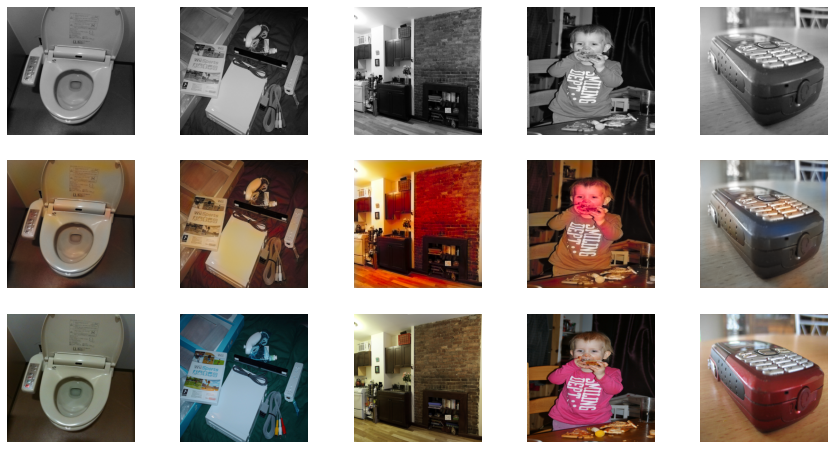

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/20
loss_D_fake: 0.57974
loss_D_real: 0.59171
loss_D: 0.58572
loss_G_GAN: 1.11644
loss_G_L1: 8.55625
loss_G: 9.67269


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


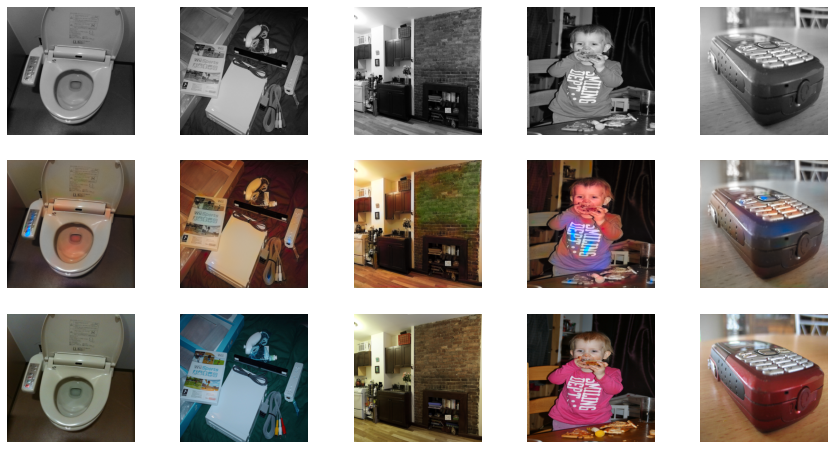

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/20
loss_D_fake: 0.58235
loss_D_real: 0.60967
loss_D: 0.59601
loss_G_GAN: 1.07689
loss_G_L1: 8.37493
loss_G: 9.45183


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


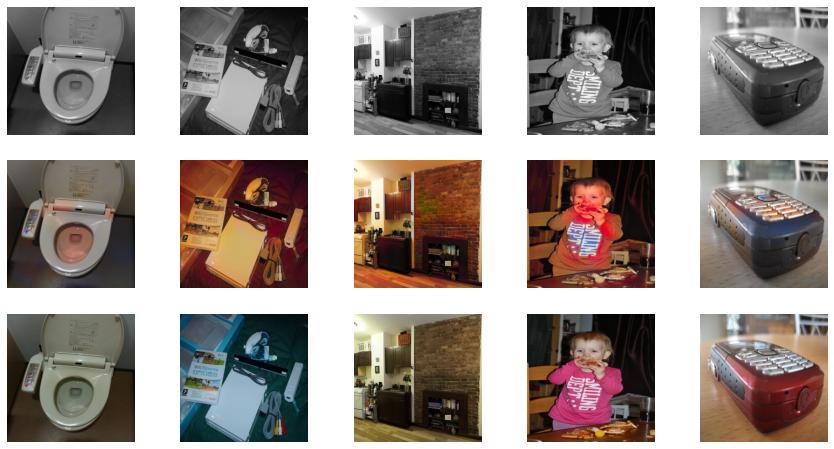

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/20
loss_D_fake: 0.59437
loss_D_real: 0.61858
loss_D: 0.60647
loss_G_GAN: 1.04239
loss_G_L1: 8.24707
loss_G: 9.28946


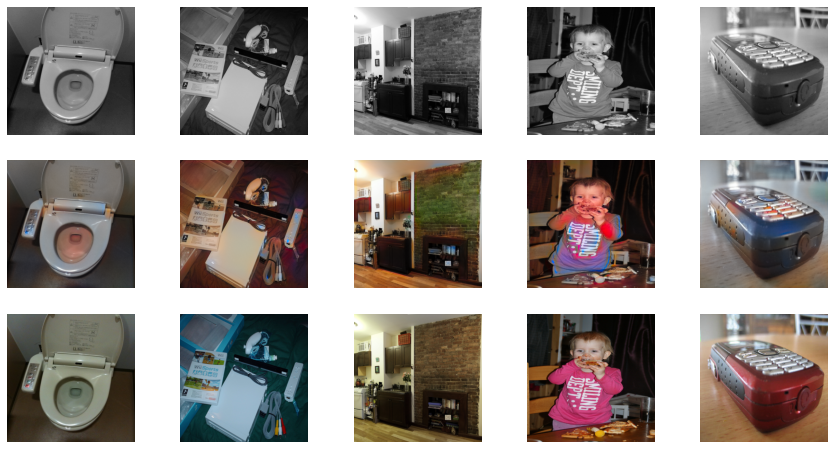

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/20
loss_D_fake: 0.60230
loss_D_real: 0.62749
loss_D: 0.61490
loss_G_GAN: 1.00284
loss_G_L1: 8.11865
loss_G: 9.12149


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


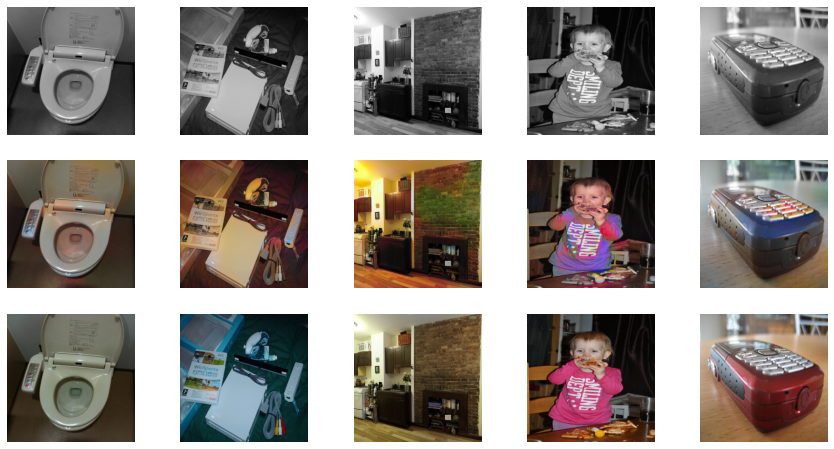

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/20
loss_D_fake: 0.60753
loss_D_real: 0.62833
loss_D: 0.61793
loss_G_GAN: 0.98565
loss_G_L1: 7.94032
loss_G: 8.92597


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


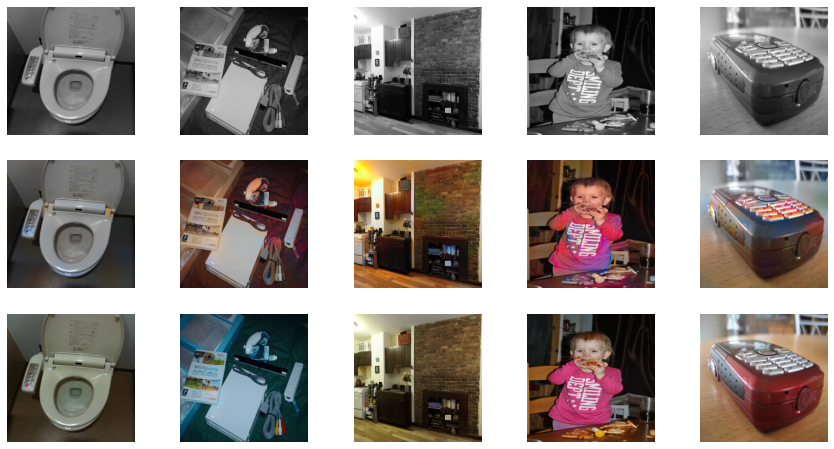

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/20
loss_D_fake: 0.60930
loss_D_real: 0.63101
loss_D: 0.62015
loss_G_GAN: 0.97130
loss_G_L1: 7.77739
loss_G: 8.74869


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


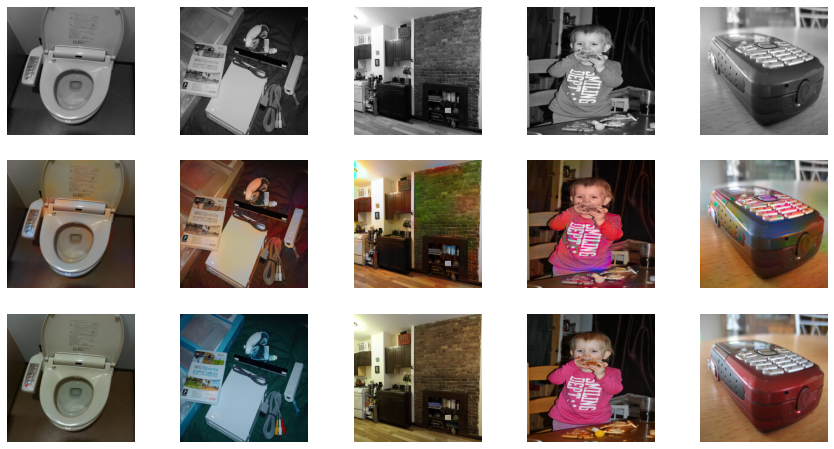

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/20
loss_D_fake: 0.61220
loss_D_real: 0.63402
loss_D: 0.62311
loss_G_GAN: 0.96363
loss_G_L1: 7.62275
loss_G: 8.58638


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 29 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 56 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


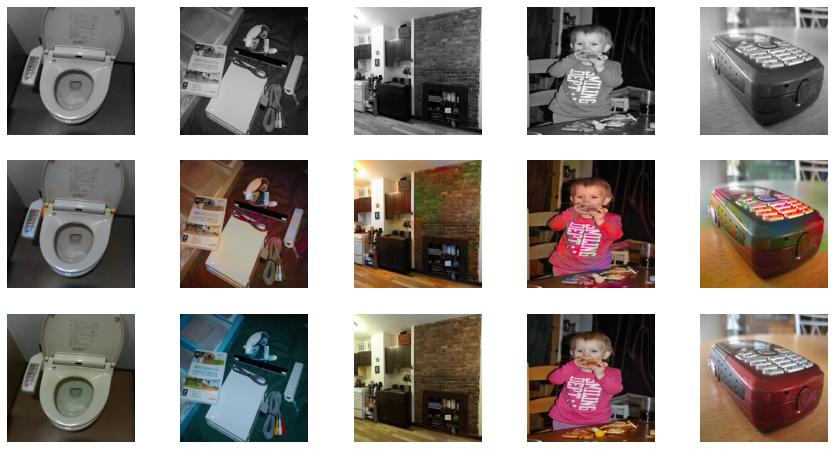

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/20
loss_D_fake: 0.61524
loss_D_real: 0.63268
loss_D: 0.62396
loss_G_GAN: 0.95342
loss_G_L1: 7.49463
loss_G: 8.44805


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 45 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


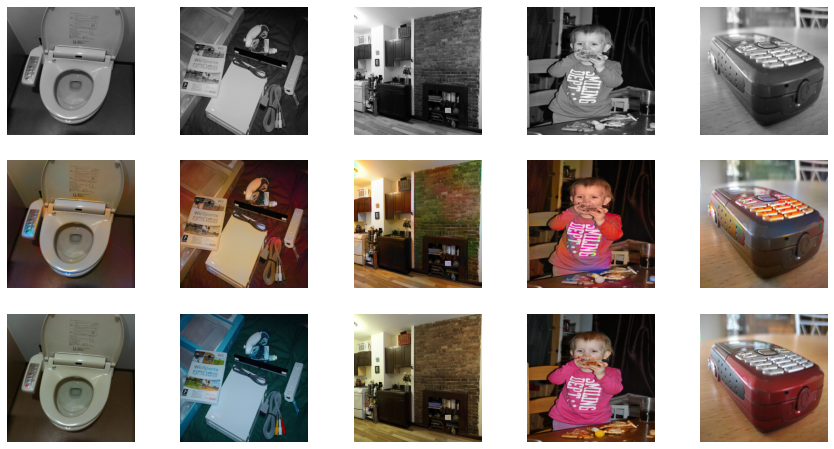

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/20
loss_D_fake: 0.61780
loss_D_real: 0.63274
loss_D: 0.62527
loss_G_GAN: 0.95091
loss_G_L1: 7.36828
loss_G: 8.31919


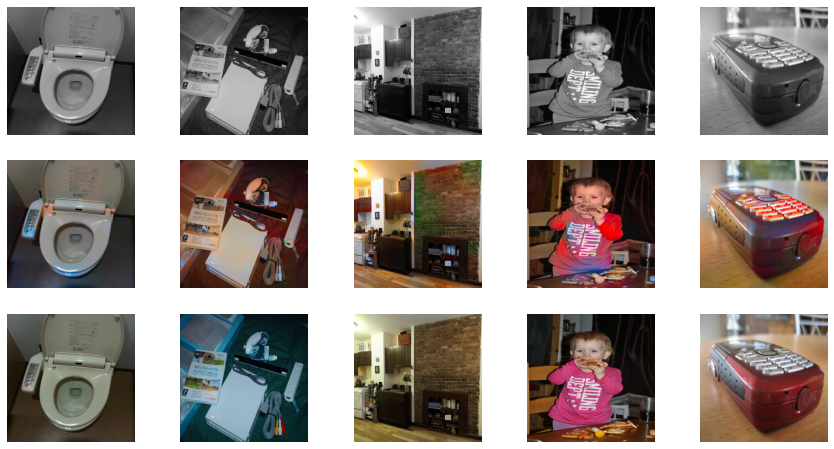

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/20
loss_D_fake: 0.61836
loss_D_real: 0.63578
loss_D: 0.62707
loss_G_GAN: 0.94648
loss_G_L1: 7.20337
loss_G: 8.14985


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


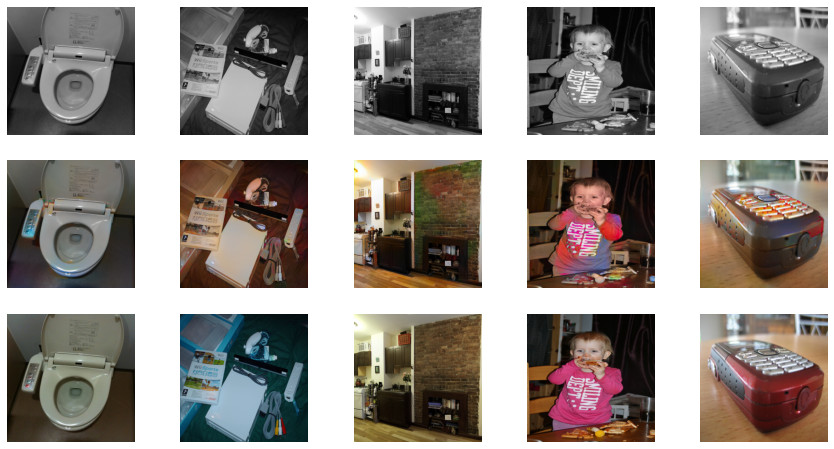

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/20
loss_D_fake: 0.62019
loss_D_real: 0.63537
loss_D: 0.62778
loss_G_GAN: 0.93940
loss_G_L1: 7.06106
loss_G: 8.00046


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


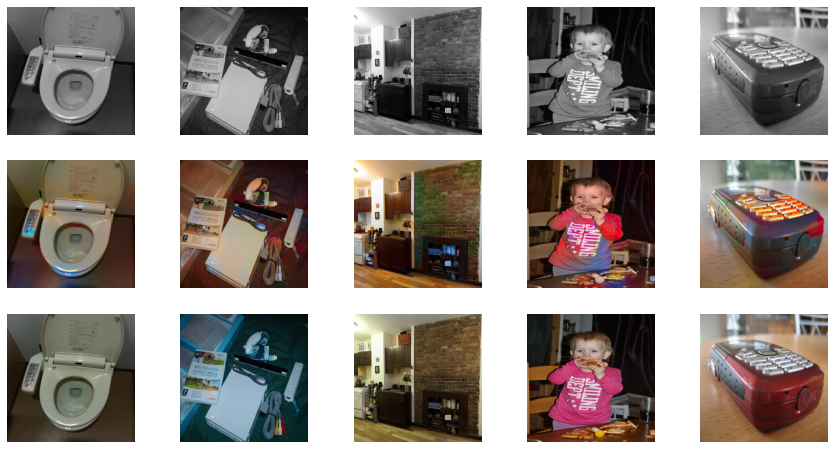

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/20
loss_D_fake: 0.62268
loss_D_real: 0.63529
loss_D: 0.62899
loss_G_GAN: 0.93301
loss_G_L1: 6.92069
loss_G: 7.85370


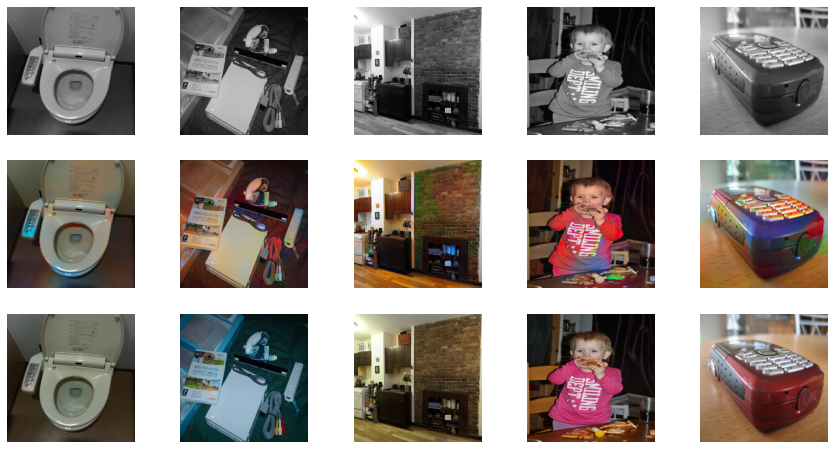

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/20
loss_D_fake: 0.62479
loss_D_real: 0.63686
loss_D: 0.63082
loss_G_GAN: 0.92544
loss_G_L1: 6.78312
loss_G: 7.70857


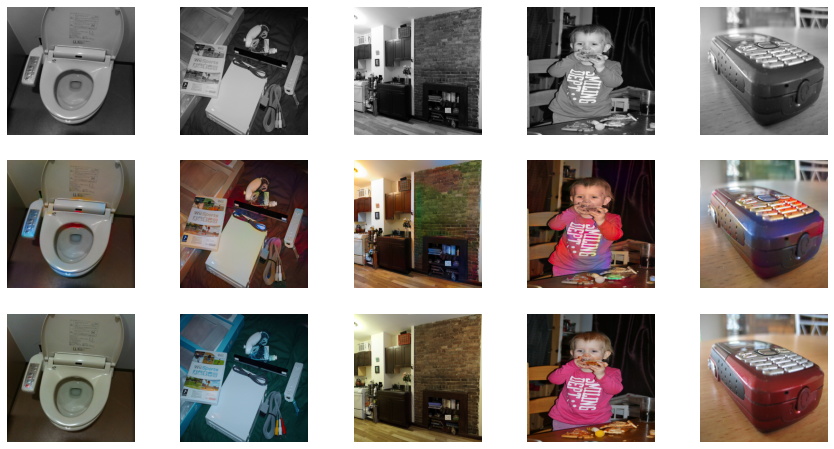

  0%|          | 0/500 [00:00<?, ?it/s]

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
train_model(model, train_dl, 20)

#**RESULTS, COMPARISIONS AND FINDINGS**
So, afters hours of traing and tweaking here we are with the final results.
Notice, the improvement we have over our previous results. The colours are more realistic and to the point. Not only the second strategy improved our results but also took less time and epochs to train.


##The case of DROPOUT
IN the begininning, in our generator architecture, the cause of the noise was the dropout layers but in the U-Net we built with the help of fastai had no dropout layers !

What does this imply ? 
The conditional GAN is still able to function without the dropout layers however the outputs will be more deterministic because of the lack of that noise but  the grayscale image has still crucial information sufficient enough for the generator to produce convincing outputs. 
But,in reality the adversarial training does give us an edge and is more fruiful.
